In [ ]:
#Links mentioned in presentation

#Pymaid
#http://pymaid.readthedocs.io/en/latest/index.html

#Plotly
#https://plot.ly/feed/


In [1]:
import pymaid
import matplotlib.pyplot as plt
import time
import networkx as nx
import numpy as np
import plotly as py
from plotly.graph_objs import *
import pandas as ps

#import sys
#sys.path.append('/Users/')


from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

from plotly import offline as poff


server = 
http_user = 
http_pw = 
token = 

def connect_adult_em():
    return pymaid.CatmaidInstance( server, http_user, http_pw, token)

connect_adult_em()

INFO  : Global CATMAID instance set. (pymaid.fetch)


In [2]:
MVP2_skid = 2333007
MVP2_neuron = pymaid.get_neuron(MVP2_skid)
MVP2_neuron.downsample(1000000, preserve_cn_treenodes = True)


M4_skid = pymaid.get_skids_by_annotation("NAM M4")
M4_skid
M4_neuron = pymaid.get_neuron(M4_skid)
M4_neuron




HBox(children=(IntProgress(value=0, description='Get neurons', max=1), HTML(value='')))

INFO  : Looking for Annotation(s): NAM M4 (pymaid.fetch)
INFO  : Found 1 skeletons with matching annotation(s) (pymaid.fetch)


HBox(children=(IntProgress(value=0, description='Get neurons', max=1), HTML(value='')))

type              <class 'pymaid.core.CatmaidNeuron'>
neuron_name        Neuron 4291900 Putative MBON-B'2mp
skeleton_id                                   4291899
n_nodes                                         37267
n_connectors                                     6235
n_branch_nodes                                   3165
n_end_nodes                                      3291
n_open_ends                                       481
cable_length                                  8835.86
review_status                                      NA
soma                                         14751714
dtype: object

HBox(children=(IntProgress(value=0, description='Plotting', max=1), HTML(value='')))

/anaconda3/lib/python3.6/site-packages/matplotlib/patches.py:121: UserWarning:

Setting the 'color' property will overridethe edgecolor or facecolor properties. 

INFO  : Done. Use matplotlib.pyplot.show() to show plot. (pymaid.plotting)


(<matplotlib.figure.Figure at 0x107d5ef60>,
 <matplotlib.axes._subplots.AxesSubplot at 0x18127ebc88>)

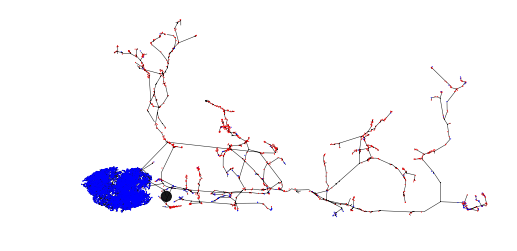

In [3]:
MVP2_neuron.plot2d()

HBox(children=(IntProgress(value=0, description='Plotting', max=1), HTML(value='')))

/anaconda3/lib/python3.6/site-packages/matplotlib/patches.py:121: UserWarning:

Setting the 'color' property will overridethe edgecolor or facecolor properties. 

INFO  : Done. Use matplotlib.pyplot.show() to show plot. (pymaid.plotting)


(<matplotlib.figure.Figure at 0x1811586358>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1811e7fb00>)

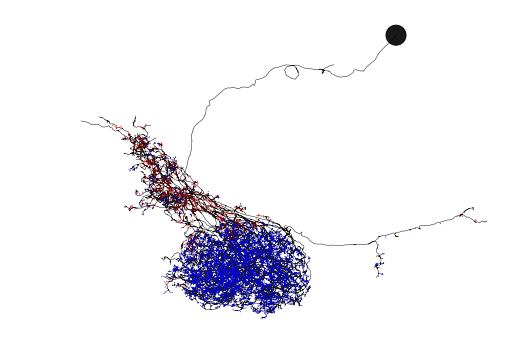

In [4]:
M4_neuron.plot2d()

In [5]:
MVP2_and_M4 = [MVP2_skid,M4_skid[0]]
MVP2_and_M4

MVP2_and_M4_neurons = pymaid.get_neurons(MVP2_and_M4)

HBox(children=(IntProgress(value=0, description='Get neurons', max=2), HTML(value='')))

HBox(children=(IntProgress(value=0, description='Make nrn', max=2), HTML(value='')))

In [6]:
figure_in_3d = MVP2_and_M4_neurons.plot3d(backend = 'plotly', connectors = True, width = 800)
poff.iplot(figure_in_3d)

INFO  : Generating traces... (pymaid.plotting)
INFO  : Tracing done. (pymaid.plotting)
INFO  : Done. Plotted 112575 nodes and 17334 connectors (pymaid.plotting)
INFO  : Use plotly.offline.plot(fig, filename="3d_plot.html") to plot. Optimised for Google Chrome. (pymaid.plotting)


In [8]:
MVP2_to_M4_connectors = pymaid.get_connectors_between(MVP2_skid, M4_skid, directional = True)
MVP2_to_M4_connectors
MVP2_to_M4_conn_id = MVP2_to_M4_connectors['connector_id']
MVP2_to_M4_conn_id
MVP2_to_M4_conn_SERIES = ps.Series.tolist(MVP2_to_M4_conn_id)

Calculating node positions...
Plotting tree...
Plotting connectors...
Done in 428s


AttributeError: 'NoneType' object has no attribute 'show'

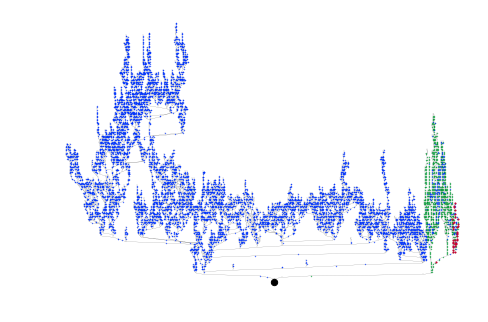

In [9]:
def plot_nx(x, plot_connectors=True, highlight_connectors=None, prog='dot'):
    """ This lets you plot neurons as dendrograms using networkx and its bindings
    to graphviz.

    Parameters
    ----------
    x :     				CatmaidNeuron
            				Neuron to plot. Strongly recommend to downsample the neuron!
    plot_connectors :       bool, optional
                            If True, connectors will be plotted
    highlight_connectors :  list of int
                            These connectors (or more precisely, the treenodes they
                            connect to) will be highlighted in green
    prog :                  {'dot','neato','fdp'}
                            Graphviz layout to use. Be aware that neato and fdp are 
                            extremely slow!

    Returns
    -------
    Nothing

    Examples
    --------
    >>> import pymaid
    >>> import matplotlib.pyplot as plt
    >>> rm = pymaid.CatmaidInstance(server,user,password,token)
    >>> # Retrieve neuron
    >>> x = pymaid.get_neuron(16)
    >>> # Downsample to just the essential treenodes (will speed up processing A LOT)
    >>> x.downsample(100000, preserve_cn_treenodes=True)
    >>> plot_nx( x, plot_connectors=True )
    >>> plt.show()
    """

    if not isinstance(x, (pymaid.CatmaidNeuron, pymaid.CatmaidNeuronList)):
        raise ValueError('Need to pass a CatmaidNeuron')
    elif isinstance(x, pymaid.CatmaidNeuronList):
        if len(x) > 1:
            raise ValueError('Need to pass a SINGLE CatmaidNeuron')
        else:
            x = x[0]

    valid_progs = ['fdp','dot','neato']
    if prog not in valid_progs:
        raise ValueError('Unknown program parameter!')

    # Save start time
    start = time.time()

    # Reroot neuron to soma if necessary
    if x.root != x.soma:
        x.reroot(x.soma)

    # This is only relevant if we use the 'neato' layout as it preserves segment lengths
    if 'parent_dist' not in x.nodes:
        x = pymaid.calc_cable(x, return_skdata=True)

    # Generate and populate networkX graph representation of the neuron
    g=nx.DiGraph()
    g.add_nodes_from( x.nodes.treenode_id.values )
    for e in x.nodes[['treenode_id','parent_id','parent_dist']].values:
        #Skip root node
        if e[1]==None:
            continue
        g.add_edge(e[0],e[1],len=e[2])

    # Calculate layout
    print('Calculating node positions...')
    pos = nx.nx_agraph.graphviz_layout(g, prog=prog)
    
    
    # Plot tree with above layout
    print('Plotting tree...')
    nx.draw(g, pos, node_size=0, arrows=False, width = 0.1)

    #Add soma
    plt.scatter([pos[x.soma][0]], [pos[x.soma][1]], s=40, c=(0,0,0), zorder=1 )

    print('Plotting connectors...')
    if plot_connectors:
        plt.scatter(  
                    [ pos[tn][0] for tn in x.connectors[x.connectors.relation==0].treenode_id.values ],
                    [ pos[tn][1] for tn in x.connectors[x.connectors.relation==0].treenode_id.values ],
                    c=(.0,.6,.2),
                    zorder=2,
                    s=0.1)

        plt.scatter(  
                    [ pos[tn][0] for tn in x.connectors[x.connectors.relation==1].treenode_id.values ],
                    [ pos[tn][1] for tn in x.connectors[x.connectors.relation==1].treenode_id.values ],
                    c=(.0,.2,1.0),
                    zorder=2,
                    s=0.1)

    if highlight_connectors != None:
        hl_cn_coords = np.array([ pos[tn] for tn in x.connectors[ x.connectors.connector_id.isin( highlight_connectors ) ].treenode_id ])
        plt.scatter( hl_cn_coords[:,0], hl_cn_coords[:,1], s = 1, c=(0.8,0.0,0.2), zorder = 3 )       


    print('Done in %is' % int( time.time()-start ))
    

MVP2_graph = plot_nx(MVP2_neuron, plot_connectors = True, highlight_connectors = MVP2_to_M4_conn_SERIES, prog = 'dot')
MVP2_graph.show()

In [11]:
def plot_nx_plotly(z, prog = 'neato'):
    "This plots an interactive networkx diagram so that specific treenode_ids of branchpoints can be examined"
    
    
    if not isinstance(z,(pymaid.CatmaidNeuron, pymaid.CatmaidNeuronList)):
        raise ValueError('Need to pass a CatmaidNeuron')
    elif isinstance(z, pymaid.CatmaidNeuronList):
        if len(z) >1:
            raise ValueError('Need to pass a SINGLE CatmaidNeuron')
        else:
            z = z[0]
    
    valid_progs = ['neato','dot']
    if prog not in valid_progs:
        raise ValueError('Unknown program parameter!')
    
    #save start time
    
    start = time.time()
    
    #reroot neuron to soma if necessary
    
    if z.root != z.soma:
        z.reroot(z.soma)
        
    #Necessary for neato layouts for preservation of segment lengths
    
    if 'parent_dist' not in z.nodes:
        z = pymaid.calc_cable(z, return_skdata = True)
    
    #Generation of networkx diagram
    
    g = nx.DiGraph()
    g.add_nodes_from(z.nodes.treenode_id.values)
    for e in z.nodes[['treenode_id','parent_id','parent_dist']].values:
        #skipping root node
        if e[1] == None:
            continue
        g.add_edge(e[0],e[1],len = e[2])
    
    #Calculate Layout
    print ('Calculating node positions...')
    pos = nx.nx_agraph.graphviz_layout(g, prog = prog)
    print ('Finished calculating node positions...')
    
    print('Now converting for plotly...')
    
    #Convering networkx nodes for plotly
    
    node_trace = Scatter(
        x = [],
        y = [],
        text = [],
        mode = 'markers',
        hoverinfo = 'text',
        marker = Marker(showscale = False))
    
    
    for node in g.nodes():
        x,y = pos[node]
        node_trace['x'].append(x)
        node_trace['y'].append(y)
        node_info = 'treenode_id:  '+str(node)
        node_trace['text'].append(node_info)
        
    
    edge_trace = Scatter(
        x = [],
        y = [],
        line = Line(width = 1.0, color = '#000'),
        hoverinfo = 'none',
        mode = 'lines')
    
    for edge in g.edges():
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        edge_trace['x'] += [x0, x1, None]
        edge_trace['y'] += [y0, y1, None]
    
    #Soma
    
    soma_trace = Scatter(
    x = [],
    y = [],
    text = [],
    mode = 'markers',
    hoverinfo = 'text',
    marker = dict(
        size = 20,
        color = 'rgb(0,0,0)'))
    
    for node in g.nodes():
        if node != z.soma:
            continue
        elif node == z.soma:
            x,y = pos[node]
            soma_trace['x'].append(x)
            soma_trace['y'].append(y)
            soma_info = 'SOMA, treenode_id:  '+str(node)
            soma_trace['text'].append(soma_info)
        else: 
            break
    
    #Connectors: 
    #relation = 0 is outputs (presynapses), relation = 1 is inputs (postsynapses)
    
    
    presynapse_connectors = z.connectors[z.connectors.relation==0].treenode_id.values
    presynapse_connector_list = presynapse_connectors.tolist()
    
    presynapse_connector_trace = Scatter(
        x=[],
        y=[],
        text=[],
        mode = 'markers',
        hoverinfo = 'text',
        marker = dict(
            size = 10,
            color = 'rgb(0,255,0)'))
    
    postsynapse_connectors = z.connectors[z.connectors.relation==1].treenode_id.values
    postsynapse_connector_list = postsynapse_connectors.tolist()
    
    postsynapse_connector_trace = Scatter(
        x=[],
        y=[],
        text=[],
        mode='markers',
        hoverinfo='text',
        marker = dict(
            size = 10,
            color = 'rgb(0,0,255)'))
    
    for node in g.nodes():
        for tn in presynapse_connector_list:
            if node == tn:
                x,y = pos[node]
                presynapse_connector_trace['x'].append(x)
                presynapse_connector_trace['y'].append(y)
                presynapse_connector_info = 'Presynapse here, treenode id:  '+str(node)
                presynapse_connector_trace['text'].append(presynapse_connector_info)
    
    for node in g.nodes():
        for tn in postsynapse_connector_list:
            if node == tn:
                x,y = pos[node]
                postsynapse_connector_trace['x'].append(x)
                postsynapse_connector_trace['y'].append(y)
                postsynapse_connector_info = 'Postsynapse here, treenode id:  '+str(node)
                postsynapse_connector_trace['text'].append(postsynapse_connector_info)
    
                
    
    print('Creating Plotly Graph')
    
    fig = Figure(data=Data([edge_trace, node_trace, soma_trace, presynapse_connector_trace, postsynapse_connector_trace]),
                layout = Layout(
                title = 'Plotly graph',
                titlefont = dict(size = 16),
                showlegend = False,
                hovermode = 'closest',
                margin = dict(b = 20, l = 50, r = 5, t= 40),
                annotations=[ dict(
                    showarrow = False,
                    xref = 'paper', yref = 'paper',
                    x = 0.005, y = -0.002 ) ],
                xaxis = XAxis(showgrid = False, zeroline = False, showticklabels = False),
                yaxis = YAxis(showgrid = False, zeroline = False, showticklabels = False)))
    
    
    return(iplot(fig))

MVP2_plotly = plot_nx_plotly(MVP2_neuron, prog = 'dot')
MVP2_plotly.show()


Calculating node positions...


KeyboardInterrupt: 

In [12]:

import seaborn as sns

RIGHT_DAN_SKIDs = pymaid.get_skids_by_annotation("NAMK_putative_PAM-y5_RIGHT")
RIGHT_DAN_NEURONS = pymaid.get_neurons(RIGHT_DAN_SKIDs)

UPSTREAM_OF_DAN_SKIDS = pymaid.get_skids_by_annotation("For_Ito_all")
UPSTREAM_OF_DAN_NEURONS = pymaid.get_neurons(UPSTREAM_OF_DAN_SKIDS)


INFO  : Looking for Annotation(s): NAMK_putative_PAM-y5_RIGHT (pymaid.fetch)
INFO  : Found 13 skeletons with matching annotation(s) (pymaid.fetch)


HBox(children=(IntProgress(value=0, description='Get neurons', max=13), HTML(value='')))

HBox(children=(IntProgress(value=0, description='Make nrn', max=13), HTML(value='')))

INFO  : Looking for Annotation(s): For_Ito_all (pymaid.fetch)


INFO  : Found 93 skeletons with matching annotation(s) (pymaid.fetch)


HBox(children=(IntProgress(value=0, description='Get neurons', max=93), HTML(value='')))

HBox(children=(IntProgress(value=0, description='Make nrn', max=93), HTML(value='')))

In [13]:
UPSTREAM_OF_DAN_ADJX = pymaid.adjacency_matrix(UPSTREAM_OF_DAN_NEURONS, RIGHT_DAN_NEURONS)

INFO  : Retrieving and filtering connectivity... (pymaid.connectivity)
INFO  : Finished! (pymaid.connectivity)


In [14]:
UPSTREAM_OF_DAN_ADJX

,3025479,3026119,3143746,3639761,3643424,5234721,5631471,5652208,5914197,5952626,6013704,6019056,6059582
1064828,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1259226,1.0,0.0,1.0,3.0,0.0,2.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
1298803,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1576584,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0
1578742,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1641089,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0
1670680,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0
1943924,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2173638,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2236828,1.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


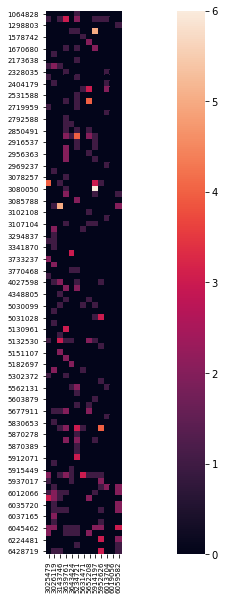

In [15]:
big, ax = plt.subplots(figsize=(20,10))
j = sns.heatmap(UPSTREAM_OF_DAN_ADJX, square = True)
j.set_yticklabels(j.get_yticklabels(), rotation =0, fontsize = 7)
j.set_xticklabels(j.get_xticklabels(), rotation = 90, fontsize =7)
plt.show()

AttributeError: 'ClusterGrid' object has no attribute 'show'

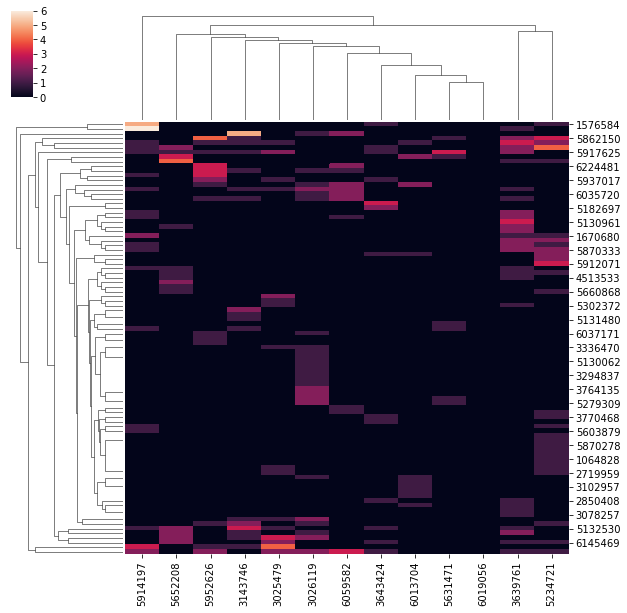

In [16]:
m = sns.clustermap(UPSTREAM_OF_DAN_ADJX)
m.show()


In [21]:
UPSTREAM_AND_DANS = RIGHT_DAN_SKIDs + UPSTREAM_OF_DAN_SKIDS
UPSTREAM_AND_DANS

circos = pymaid.plot_network(UPSTREAM_AND_DANS, layout = nx.circular_layout, 
                             groups = {'RIGHT DANs' : [(RIGHT_DAN_SKIDs)], 'UPSTREAM of DANs' : [UPSTREAM_OF_DAN_SKIDS]}, syn_threshold= 3)
poff.plot(circos)

INFO  : Done! Use e.g. plotly.offline.plot(fig, filename="network_plot.html") to plot. (pymaid.plotting)


'file:///Users/MarkusPleijzier/Pymaid Demo/temp-plot.html'

In [17]:
RIGHT_DAN_NEURONS.connectors


,treenode_id,connector_id,relation,x,y,z
0,20447715,20447714,1,499743,157184,41920
1,20447723,20447724,1,497975,159302,44640
2,20447683,19984327,1,502670,172188,63080
3,20447704,20447703,1,503329,153019,38200
4,20447696,20447695,0,503239,153684,37400
5,20447732,20447736,1,499299,156554,40680
6,20447732,20447738,1,499533,156484,40680
7,20447732,20447740,1,499731,156632,40680
8,20447836,20447835,1,537859,170728,30200
9,18417488,20447743,0,498523,159566,45200


In [18]:
RIGHT_DAN_PRESYNAPSES = RIGHT_DAN_NEURONS.connectors[RIGHT_DAN_NEURONS.connectors.relation == 0]
RIGHT_DAN_PRESYNAPSES

,treenode_id,connector_id,relation,x,y,z
4,20447696,20447695,0,503239,153684,37400
9,18417488,20447743,0,498523,159566,45200
25,20448025,20448027,0,505844,156187,51920
27,20217978,20448053,0,505840,158201,53480
29,20448061,20448062,0,505304,158365,53080
33,20448068,20448069,0,507916,161869,55080
39,20448496,20448495,0,495213,179581,42680
41,20448529,20448528,0,495996,180307,43960
42,12206501,20448569,0,495478,179573,48560
49,20449426,20449428,0,495398,177779,43440


INFO  : Clustering done using method "ward" (pymaid.cluster)
INFO  : Use matplotlib.pyplot.show() to render figure. (pymaid.cluster)


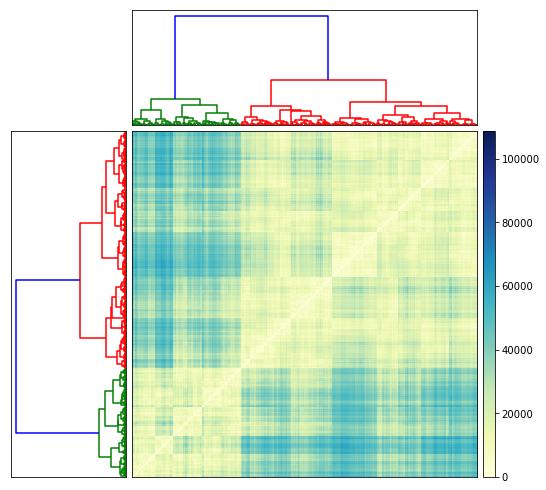

In [19]:
RIGHT_DAN_CLUSTERS_XYZ = pymaid.cluster_xyz(RIGHT_DAN_PRESYNAPSES)
RIGHT_DAN_CLUSTERS_XYZ.plot_matrix()
plt.show()